In [ ]:
from icevision.all import *

In [39]:
#Definir Path
data_dir = Path('./Descargas/Train')

parser = parsers.VOCBBoxParser(annotations_dir=data_dir/'Annotations', images_dir=data_dir/'JPEGImages')

In [ ]:
# Default 80% 20%
train_records, valid_records = parser.parse()

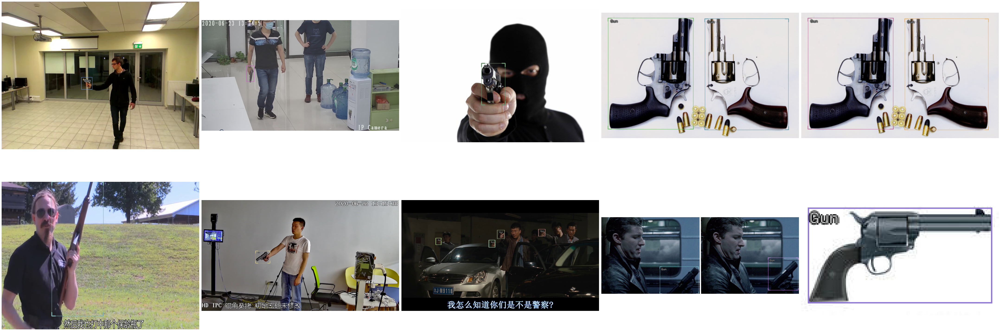

In [41]:
%matplotlib inline  
show_records(random.choices(train_records, k=10), ncols=5)

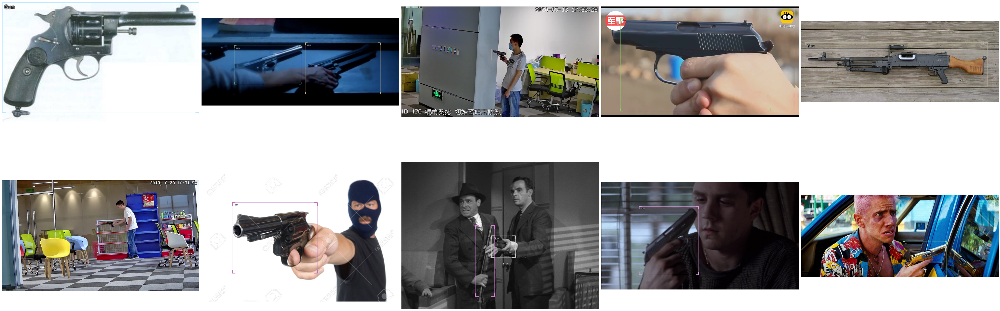

In [42]:
%matplotlib inline  
show_records(random.choices(valid_records, k=10), ncols=5)

In [43]:
### Creamos el parser personalizado para los datos negativos
negative_template_record = ObjectDetectionRecord()

Parser.generate_template(negative_template_record)

class MyParser(Parser):
    def __init__(self, template_record):
        super().__init__(template_record=template_record)
    def __iter__(self) -> Any:
    def __len__(self) -> int:
    def record_id(self, o: Any) -> Hashable:
    def parse_fields(self, o: Any, record: BaseRecord, is_new: bool):
        record.set_img_size(<ImgSize>)
        record.set_filepath(<Union[str, Path]>)
        record.detection.set_class_map(<ClassMap>)
        record.detection.add_labels(<Sequence[Hashable]>)
        record.detection.add_bboxes(<Sequence[BBox]>)


In [44]:
### No necesitamos los metodos para detectar, por lo que no añademos bboxes
class NegativeImageParser(Parser):
    def __init__(self, template_record, data_dir):
        super().__init__(template_record=template_record)
        self.image_filepaths = get_image_files(data_dir) ### Para que el parser obtenga las imagenes

    def __iter__(self) -> Any:
        yield from self.image_filepaths

    def __len__(self) -> int:
        return len(self.image_filepaths)

    def record_id(self, o) -> Hashable:
        return o.stem

    def parse_fields(self, o, record, is_new):
        if is_new:
            record.set_img_size(get_img_size(o))
            record.set_filepath(o)


In [45]:
#Definimos los path de los negativos
negative_1_path = Path('./Descargas/Error/JPEGImages')
negative_2_path = Path('./Descargas/Error2')

In [46]:
negative_1_parser = NegativeImageParser(negative_template_record, negative_1_path)
negative_2_parser = NegativeImageParser(negative_template_record, negative_2_path)

In [ ]:
train_negative1_records, valid_negative1_records = negative_1_parser.parse()

In [ ]:
train_negative2_records, valid_negative2_records = negative_2_parser.parse()

In [49]:
train_negative_records = train_negative1_records + train_negative2_records

In [50]:
valid_negative_records = valid_negative1_records + valid_negative2_records

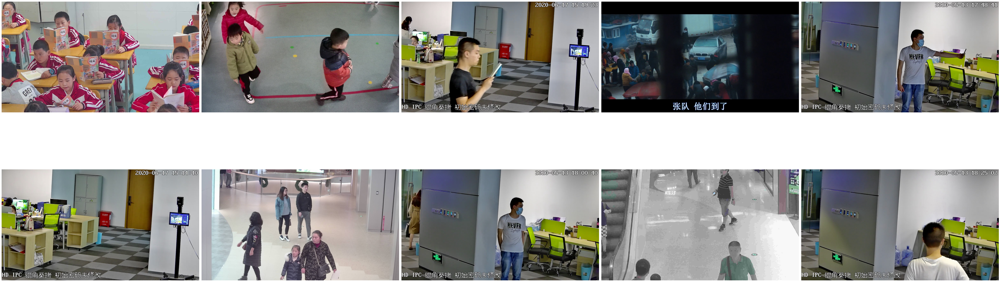

In [51]:
%matplotlib inline  
show_records(random.choices(train_negative_records, k=10), ncols=5)

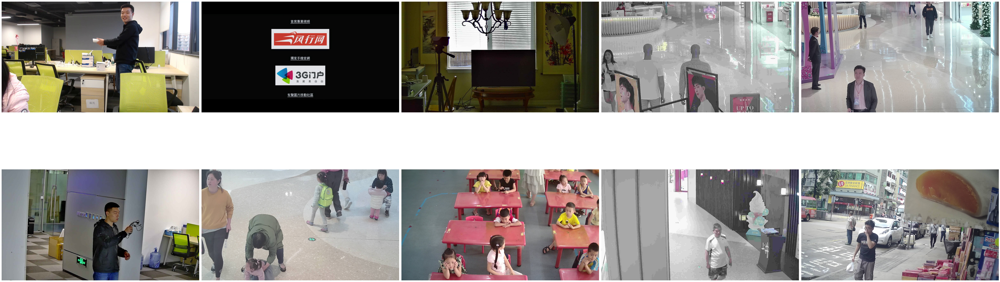

In [52]:
%matplotlib inline  
show_records(random.choices(valid_negative_records, k=10), ncols=5)

In [53]:
# Transformaciones: aplica aleatoriamente transformaciones, rotación, recorte, volteo horizontal, etc.
image_size = 384 # EfficientDet requires its inputs to be divisible by 128
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=512), tfms.A.Normalize()])
#train_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

In [54]:
### Creamos el dataset combinado
# Datasets
train_ds = Dataset(train_records+train_negative_records, train_tfms)
valid_ds = Dataset(valid_records+valid_negative_records, valid_tfms)

In [55]:
### Creamos el modelo
extra_args = {}
model_type = models.ultralytics.yolov5
backbone = model_type.backbones.small
  # The yolov5 model requires an img_size parameter
extra_args['img_size'] = image_size

In [56]:
### Creamos el dataloader
train_dl = model_type.train_dl(train_ds, batch_size=4, num_workers=4, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=4, num_workers=4, shuffle=False)

In [57]:
from fastai.callback.wandb import *
from fastai.callback.tracker import SaveModelCallback

In [ ]:
wandb.init(project="negativeData", name="yolov5-lessSize", reinit=True)

In [ ]:
model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(parser.class_map), **extra_args) 

In [60]:
backbone.__dict__

{'model_name': 'yolov5s', 'pretrained': True}

In [61]:
parser.class_map

<ClassMap: {'background': 0, 'gun': 1}>

In [95]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

In [62]:
learn = model_type.fastai.learner(dls=[train_dl, valid_dl], model=model, 
                                  metrics=[COCOMetric(metric_type=COCOMetricType.bbox)], 
                                  cbs=[WandbCallback(), SaveModelCallback()])


SuggestedLRs(valley=0.0030199517495930195)

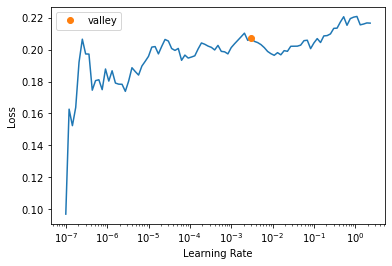

In [63]:
%matplotlib inline
learn.lr_find()

In [64]:

### EVITAMOS ERRORES CON IMAGENES CORRUPTAS
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True


In [65]:
learn.fine_tune(5, 0.0030) # fine_tune(numero epocas, ratio de aprendizaje, epocas congeladas)

Could not gather input dimensions
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'Dataset' object has no attribute 'items'


epoch,train_loss,valid_loss,COCOMetric,time
0,0.096596,0.067085,0.175244,23:25


Better model found at epoch 0 with valid_loss value: 0.06708512455224991.
Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,0.079044,0.049514,0.371151,28:23
1,0.068765,0.046473,0.399733,28:17
2,0.063654,0.041613,0.464224,28:16
3,0.056273,0.040274,0.474965,28:19
4,0.054161,0.038242,0.498539,28:10


Better model found at epoch 0 with valid_loss value: 0.04951373487710953.
Better model found at epoch 1 with valid_loss value: 0.04647291824221611.
Better model found at epoch 2 with valid_loss value: 0.041613392531871796.
Better model found at epoch 3 with valid_loss value: 0.04027385637164116.
Better model found at epoch 4 with valid_loss value: 0.03824184834957123.


In [66]:
from icevision.models import *

In [67]:
checkpoint_path = 'dataSetGrande.pth'

save_icevision_checkpoint(model, 
                        model_name='ultralytics.yolov5', 
                        backbone_name='small',
                        classes =  parser.class_map.get_classes(), 
                        img_size=image_size, 
                        filename=checkpoint_path,
                        meta={'icevision_version': '0.12.0'})
